In [15]:
from detectron2_predictor import Detectron2Predictor
from utilities import create_file_list, imshow_jupyter

data_dir = '/home/gregory/Documents/RainPerception/' # Local Jupyter

In [2]:
# predictor_clear = Detectron2Predictor(head='SemanticSegmentation', model_path='output_combined_clear_20k/model_final.pth')
# predictor_all = Detectron2Predictor(head='SemanticSegmentation', model_path='output_combined_all_40k/model_final.pth')
# predictor_cs = Detectron2Predictor(head='SemanticSegmentation', model_path='output_cityscapes_clear_20k/model_final.pth')

In [3]:
predictor_clear = Detectron2Predictor(head='SemanticSegmentation', model_path='old_combined_clear/model_final.pth')
predictor_all = Detectron2Predictor(head='SemanticSegmentation', model_path='old_combined_all/model_final.pth')
predictor_cs = Detectron2Predictor(head='SemanticSegmentation', model_path='old_cityscapes_clear/model_final.pth') # Actually Rain + Clear at Night

Shape of sem_seg_head.predictor.bias in checkpoint is torch.Size([14]), while shape of sem_seg_head.predictor.bias in model is torch.Size([17]).
sem_seg_head.predictor.bias will not be loaded. Please double check and see if this is desired.
Shape of sem_seg_head.predictor.weight in checkpoint is torch.Size([14, 128, 1, 1]), while shape of sem_seg_head.predictor.weight in model is torch.Size([17, 128, 1, 1]).
sem_seg_head.predictor.weight will not be loaded. Please double check and see if this is desired.
Skip loading parameter 'sem_seg_head.predictor.bias' to the model due to incompatible shapes: (14,) in the checkpoint but (17,) in the model! You might want to double check if this is expected.
Skip loading parameter 'sem_seg_head.predictor.weight' to the model due to incompatible shapes: (14, 128, 1, 1) in the checkpoint but (17, 128, 1, 1) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
sem_seg_head.p

# Quick test: Prediction image

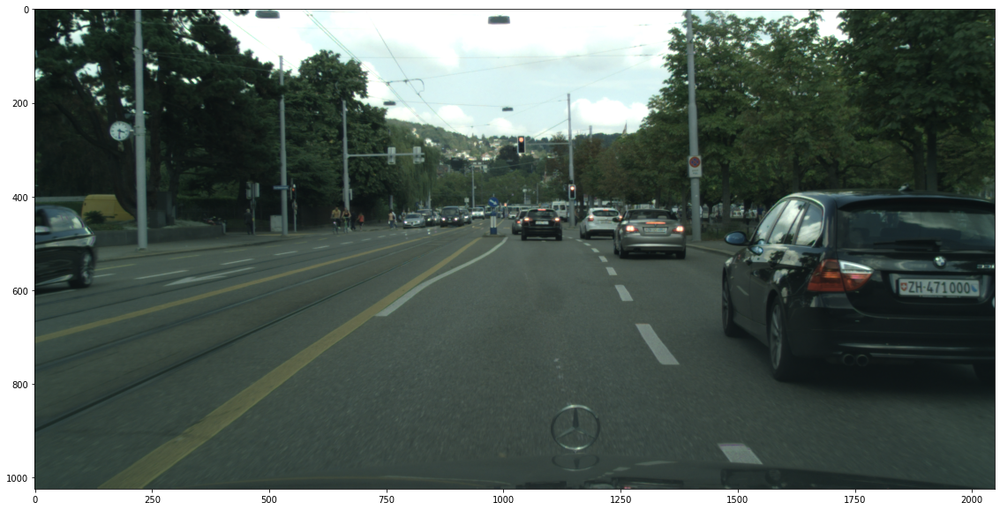

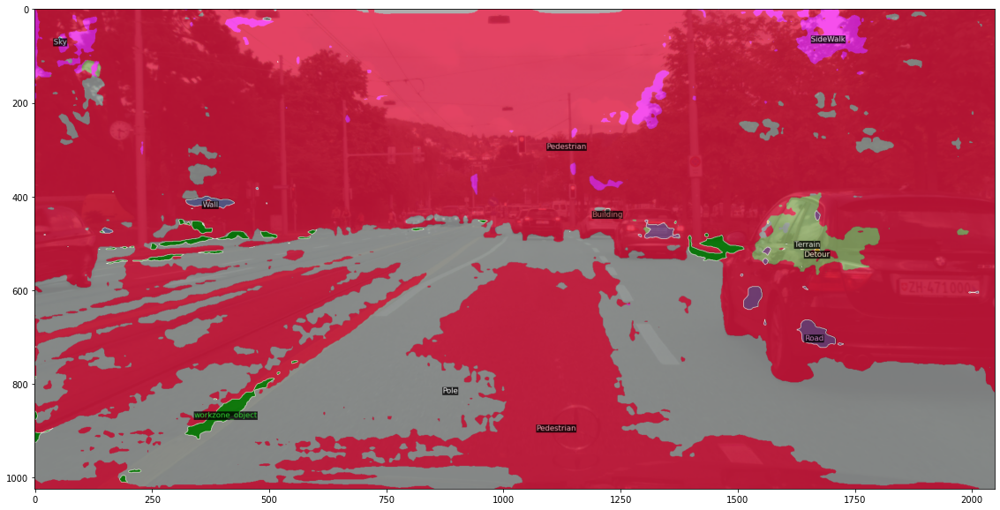

Time = 0.06870484352111816, freq = 14.5550145921317


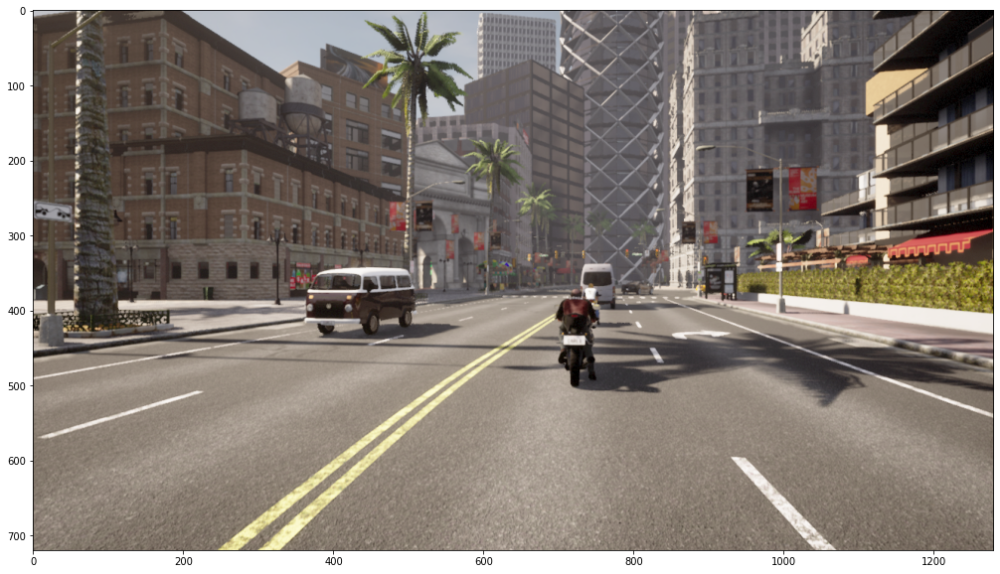

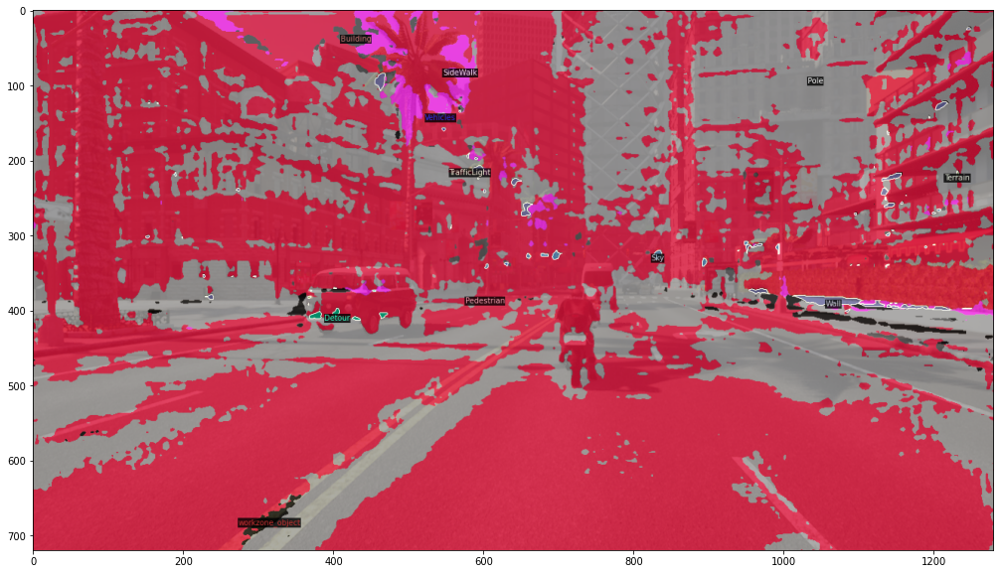

Time = 0.04860496520996094, freq = 20.57402974532041


In [4]:
sample_file_path = data_dir + 'Cityscapes/leftImg8bit/train/zurich/zurich_000037_000019_leftImg8bit.png'
test = predictor_cs.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

sample_file_path = data_dir + 'Carla/packaging/package4/1647150056.5302405_clear.png'
test = predictor_cs.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

# print(test.shape)
# print(test)
# imshow_jupyter(test)

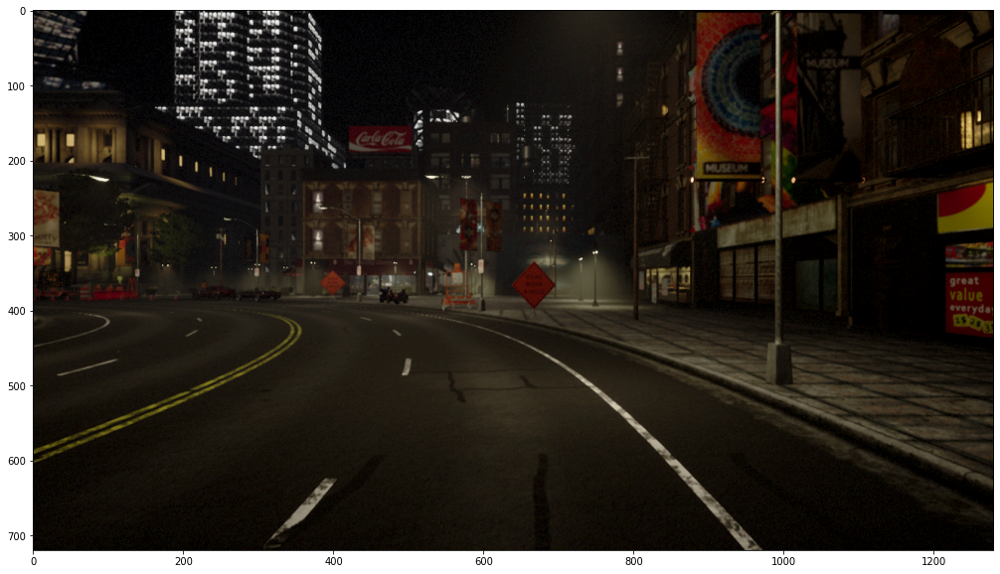

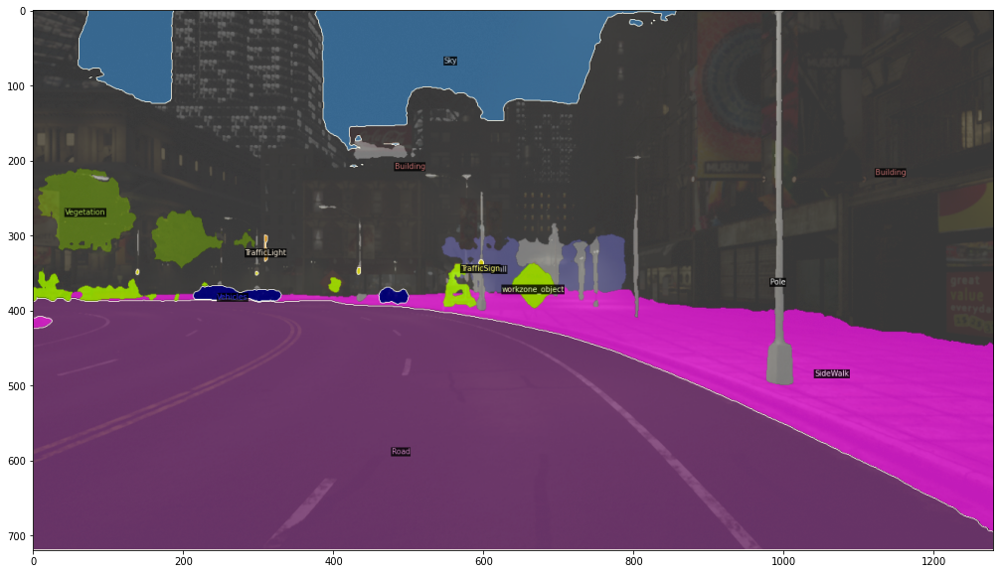

Time = 0.02507638931274414, freq = 39.87814942288311


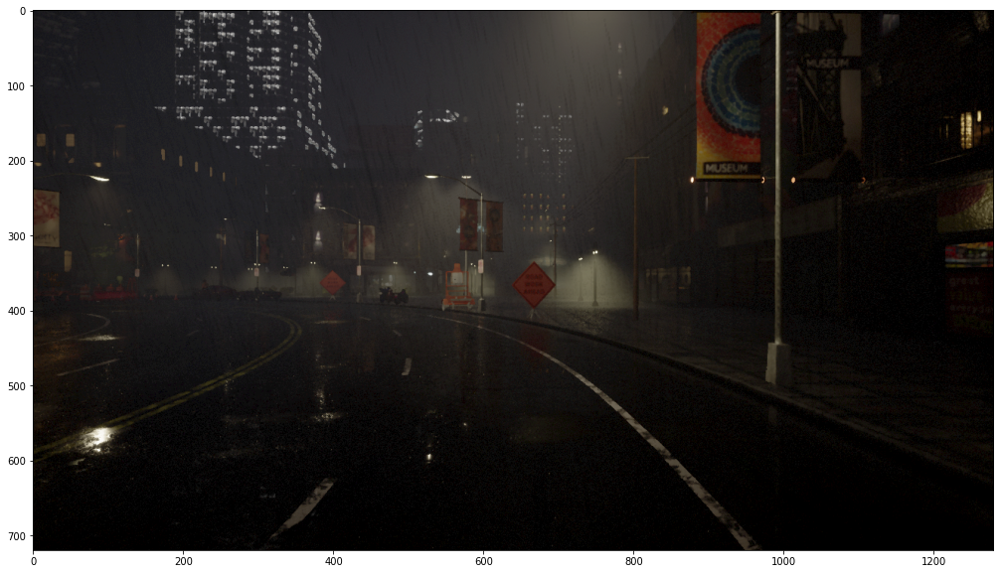

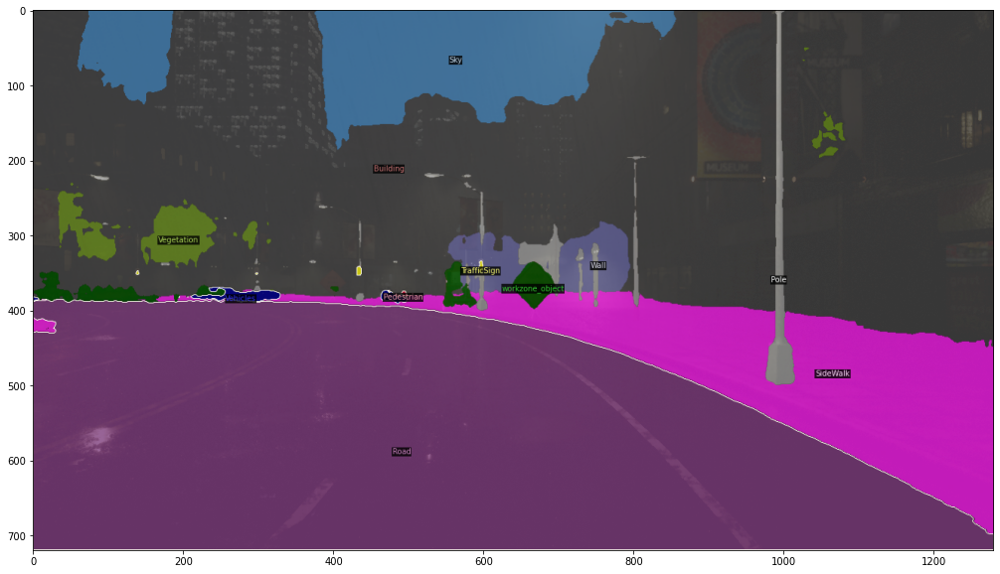

Time = 0.024927377700805664, freq = 40.11653419796658


In [20]:
predictor_constr = Detectron2Predictor(head='SemanticSegmentation', model_path='output_both_40k/model_final.pth')

sample_file_path = data_dir + 'CarlaNight/night_packaging/carla_data_night_1/1656191069.037036_clear.png'
test = predictor_constr.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

sample_file_path = data_dir + 'CarlaNight/night_packaging/carla_data_night_1/1656191069.037036_rain_H.png'
test = predictor_constr.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

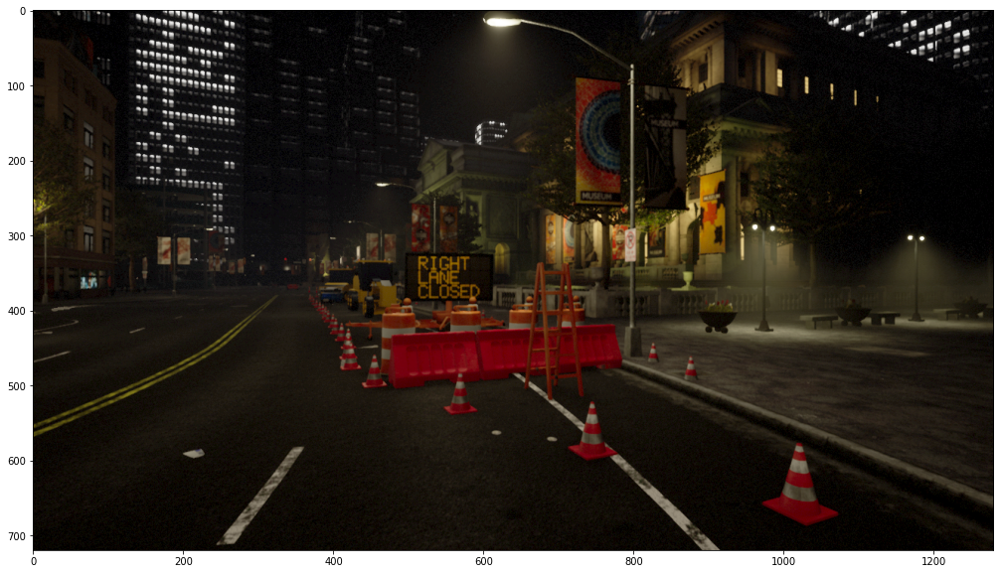

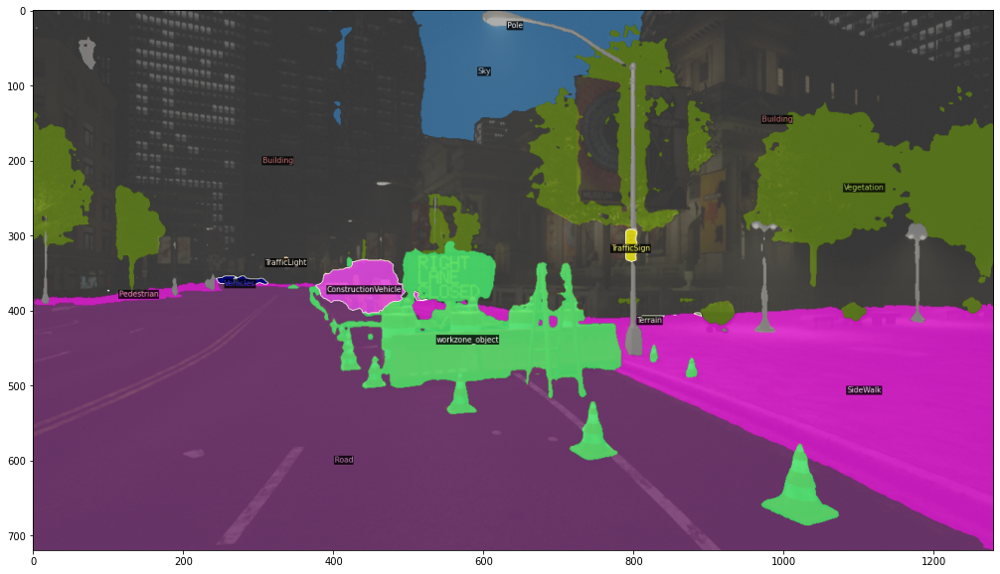

Time = 0.026041030883789062, freq = 38.40093752288874


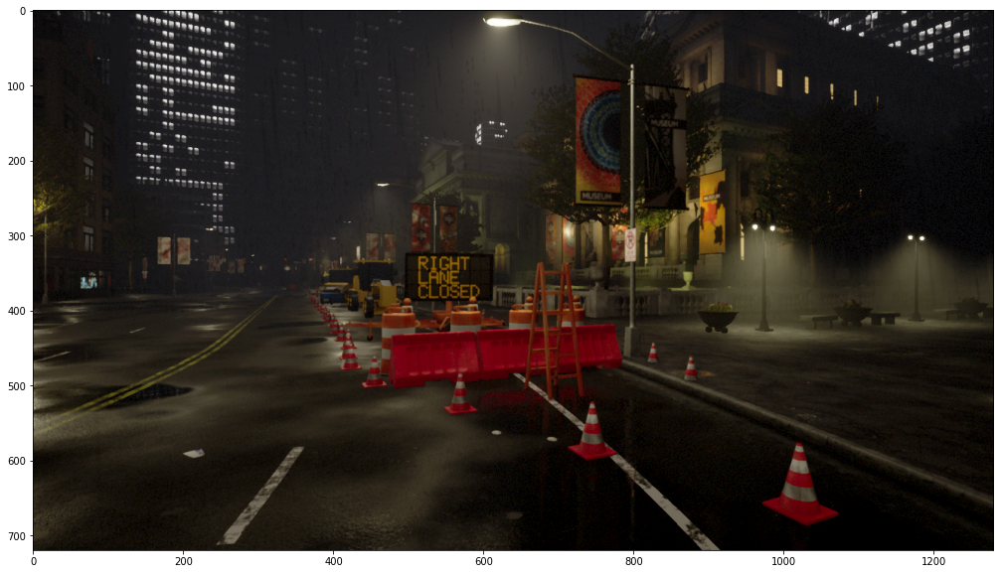

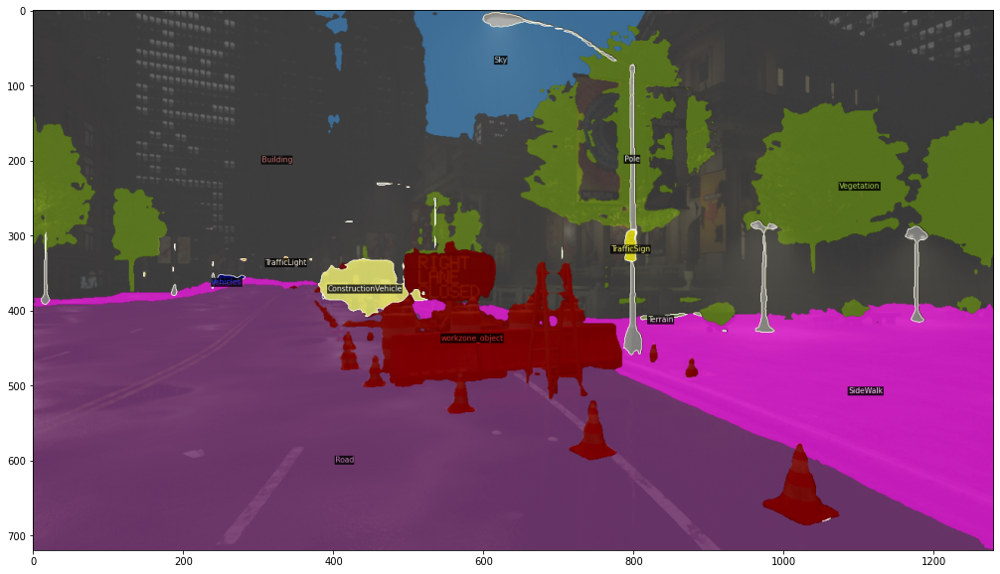

Time = 0.02638101577758789, freq = 37.90604609127881


In [21]:
sample_file_path = data_dir + 'CarlaNight/night_packaging/carla_data_night_1/1656191162.546683_clear.png'
test = predictor_constr.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

sample_file_path = data_dir + 'CarlaNight/night_packaging/carla_data_night_1/1656191162.546683_rain_S.png'
test = predictor_constr.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

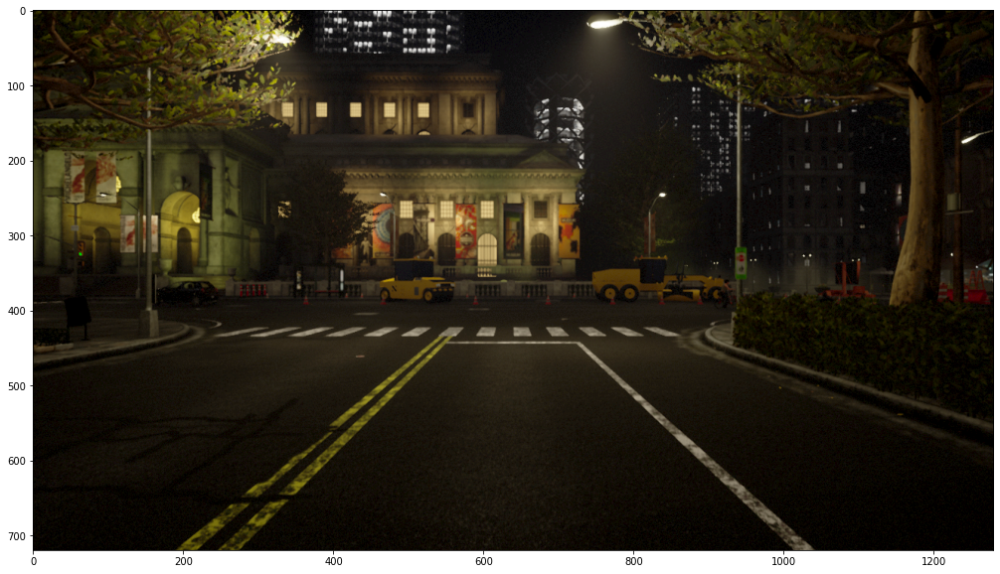

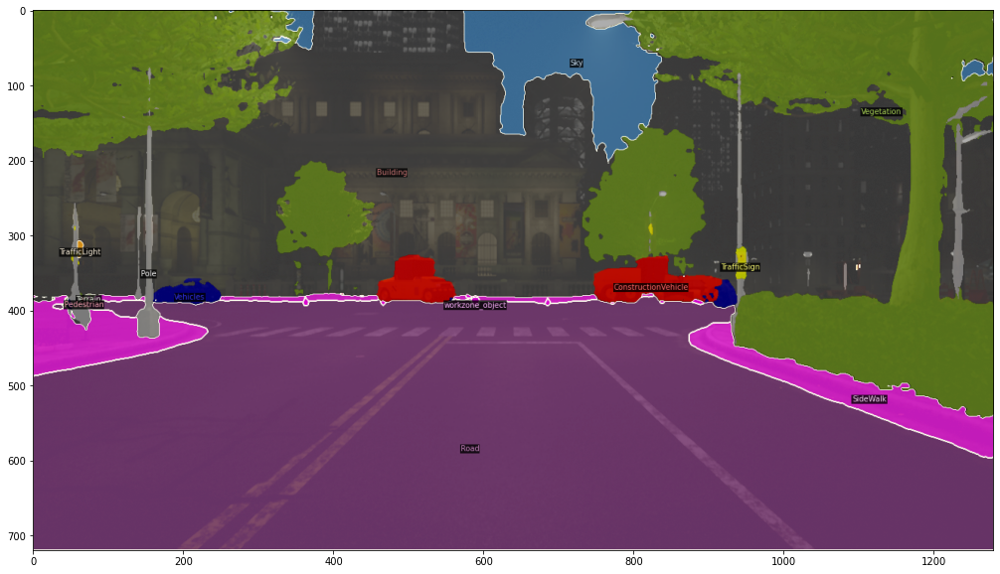

Time = 0.038208961486816406, freq = 26.171870710096094


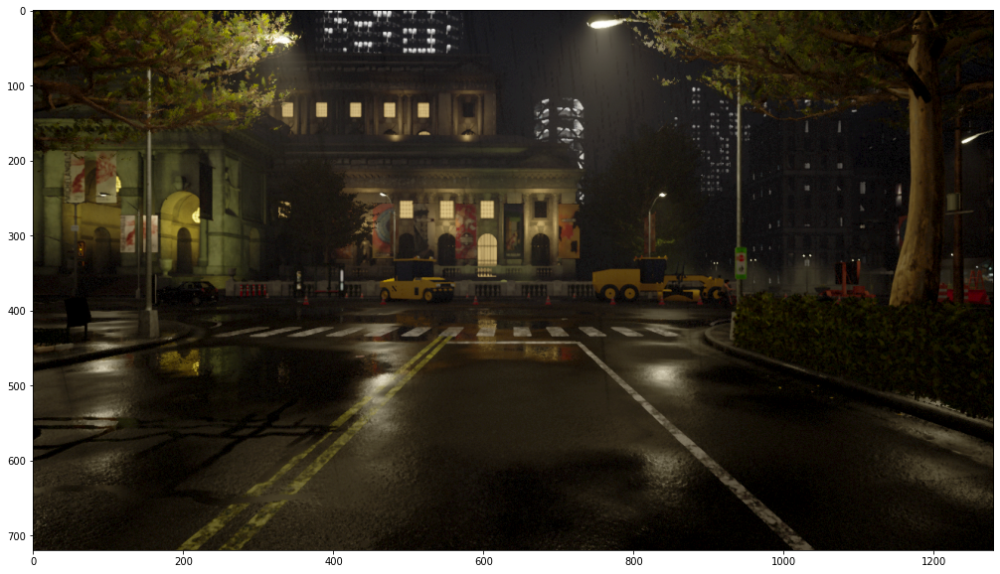

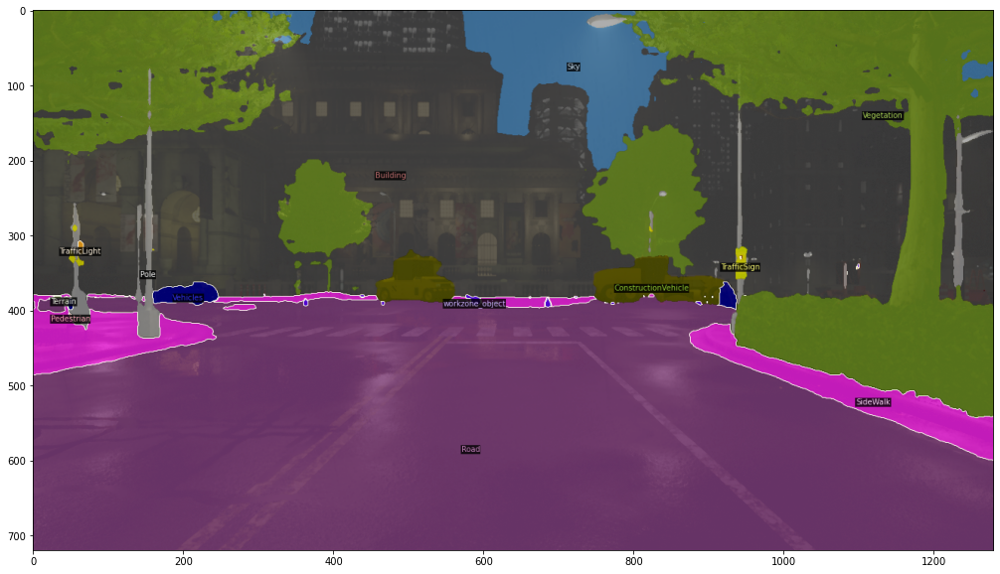

Time = 0.02497386932373047, freq = 40.04185282773896


In [22]:
sample_file_path = data_dir + 'CarlaNight/night_packaging/carla_data_night_2/1656195814.9736419_clear.png'
test = predictor_constr.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

sample_file_path = data_dir + 'CarlaNight/night_packaging/carla_data_night_2/1656195814.9736419_rain_M.png'
test = predictor_constr.test_image_file(sample_file_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

# Batch running

In [7]:
data_dir_rain_removal = '/home/tunx404/Miscellaneous/data/temp'
data_dir_rain_removal = '/home/gregory/Documents/RainPerception/RainRemoval/Copied/generated_test'

_, rain_removal_file_path_list = create_file_list('/', data_dir_rain_removal)

for file_path in rain_removal_file_path_list[:10]:
    output = predictor_clear.test_image_file(sample_file_path, measure_time=True) # , show_prediction=True, show_original=True

Time = 0.024631500244140625, freq = 40.59842031903361
Time = 0.02579498291015625, freq = 38.767228630582665
Time = 0.025722980499267578, freq = 38.87574381314302
Time = 0.02483987808227539, freq = 40.257846543681495
Time = 0.024322509765625, freq = 41.114178168130486
Time = 0.025244474411010742, freq = 39.61262903393368
Time = 0.024378299713134766, freq = 41.0200880195599
Time = 0.024472475051879883, freq = 40.86223391300112
Time = 0.024115562438964844, freq = 41.466998853165656
Time = 0.024327993392944336, freq = 41.10491086741344


# Quick test: Raw prediction labels

In [8]:
# sample_file_path = '/home/tunx404/Miscellaneous/data/Carla/packaging/package8/1647661117.1132371_rain_H.png'

# test = predictor_clear.test_image_file(sample_file_path, output_prediction=True)
# test = test.cpu().numpy()

# print(test.shape)
# # print(test)
# # for i in test:
# #     print(i.shape)
# #     print(i)
# #     imshow_jupyter(i)

# Predict and save

In [9]:
# from utilities import create_file_list, imshow_jupyter
# import os, cv2
# # img_path = '/home/tunx404/Miscellaneous/logs/carla_resized/output/output_resized/packaging/_out/'
# img_path = '/home/tunx404/Miscellaneous/logs/carla_cycada/output/output_14/packaging/_out/'
# _, file_path_list = create_file_list(sub_dir=(img_path))
# output_dir = img_path + 'seg/'

# for file_path in file_path_list:
#     if 'png' in file_path:
#         image = predictor_cs.test_image_file(file_path, measure_time=True)
#         output_file_name = os.path.join(output_dir, os.path.basename(file_path))
#         cv2.imwrite(output_file_name, cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

# Cityscapes

In [10]:
data_dir_cityscapes = data_dir + 'Cityscapes/leftImg8bit/'
anno_dir_cityscapes = data_dir + 'Cityscapes/gtFine/'

_, sample_cityscapes_file_path_list = create_file_list(sub_dir=(data_dir_cityscapes + 'train/cologne'))

print(sample_cityscapes_file_path_list[:5])

# sample_video_file_path = 'data/videos/video-clip.mp4'
# predictor.test_video_file(sample_video_file_path)

# image_path = 'data/test.png'
# predictor.test_image_file(image_path)

['/home/gregory/Documents/RainPerception/Cityscapes/leftImg8bit/train/cologne/cologne_000000_000019_leftImg8bit.png', '/home/gregory/Documents/RainPerception/Cityscapes/leftImg8bit/train/cologne/cologne_000001_000019_leftImg8bit.png', '/home/gregory/Documents/RainPerception/Cityscapes/leftImg8bit/train/cologne/cologne_000002_000019_leftImg8bit.png', '/home/gregory/Documents/RainPerception/Cityscapes/leftImg8bit/train/cologne/cologne_000003_000019_leftImg8bit.png', '/home/gregory/Documents/RainPerception/Cityscapes/leftImg8bit/train/cologne/cologne_000004_000019_leftImg8bit.png']


# Semantic Segmentation

Shape of sem_seg_head.predictor.bias in checkpoint is torch.Size([14]), while shape of sem_seg_head.predictor.bias in model is torch.Size([17]).
sem_seg_head.predictor.bias will not be loaded. Please double check and see if this is desired.
Shape of sem_seg_head.predictor.weight in checkpoint is torch.Size([14, 128, 1, 1]), while shape of sem_seg_head.predictor.weight in model is torch.Size([17, 128, 1, 1]).
sem_seg_head.predictor.weight will not be loaded. Please double check and see if this is desired.
Skip loading parameter 'sem_seg_head.predictor.bias' to the model due to incompatible shapes: (14,) in the checkpoint but (17,) in the model! You might want to double check if this is expected.
Skip loading parameter 'sem_seg_head.predictor.weight' to the model due to incompatible shapes: (14, 128, 1, 1) in the checkpoint but (17, 128, 1, 1) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
sem_seg_head.p

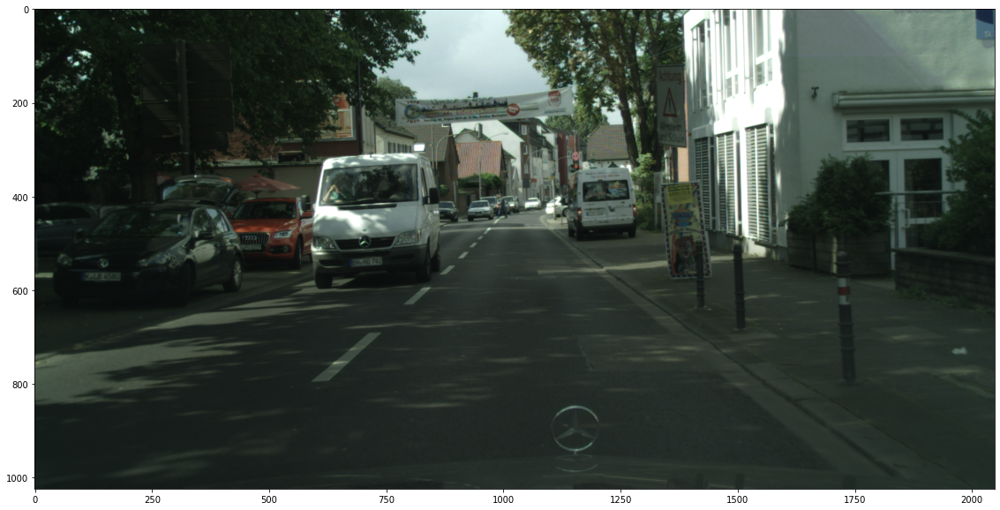

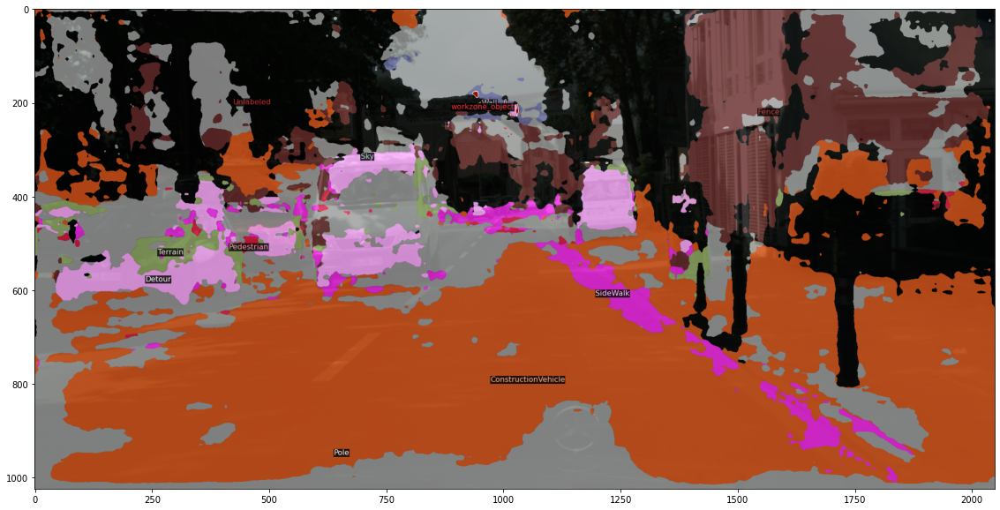

Time = 0.029869794845581055, freq = 33.478636367264514


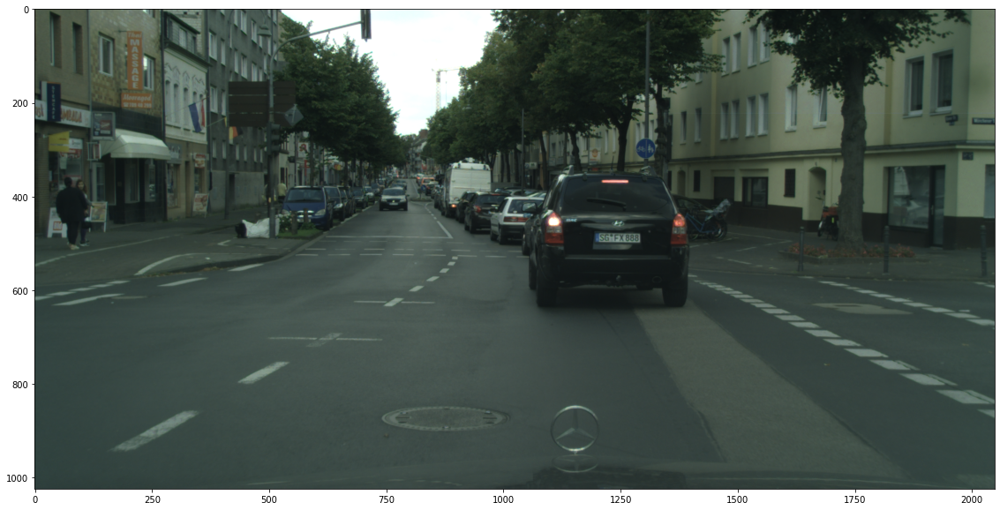

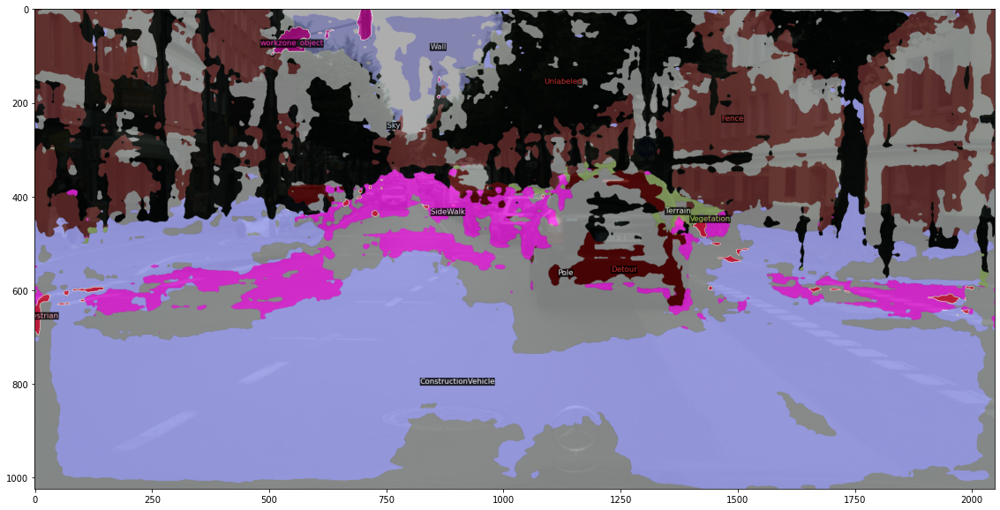

Time = 0.029508113861083984, freq = 33.888984050547


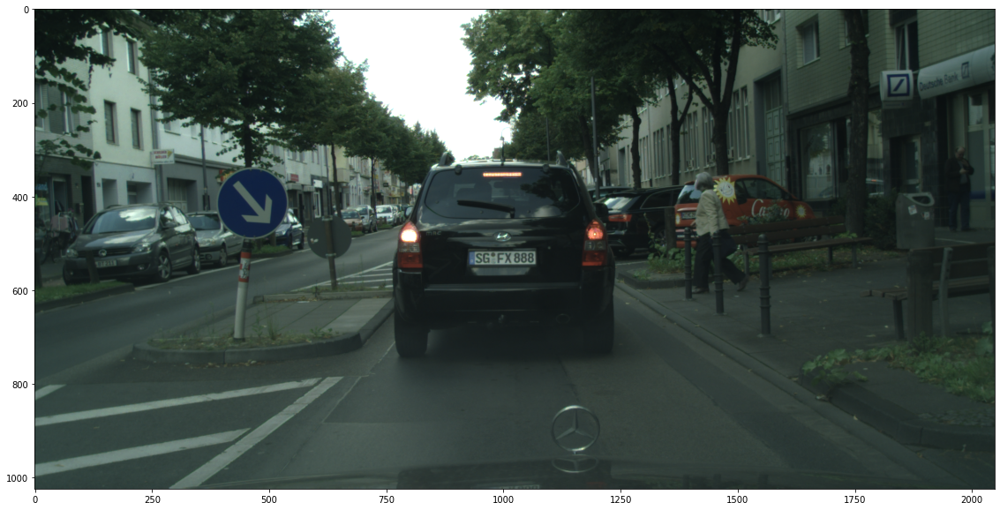

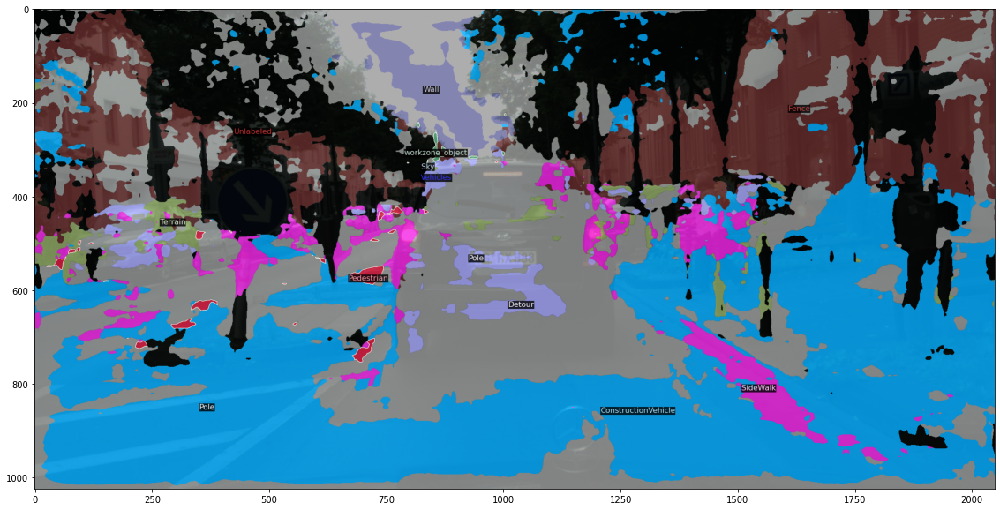

Time = 0.029770851135253906, freq = 33.589902937502


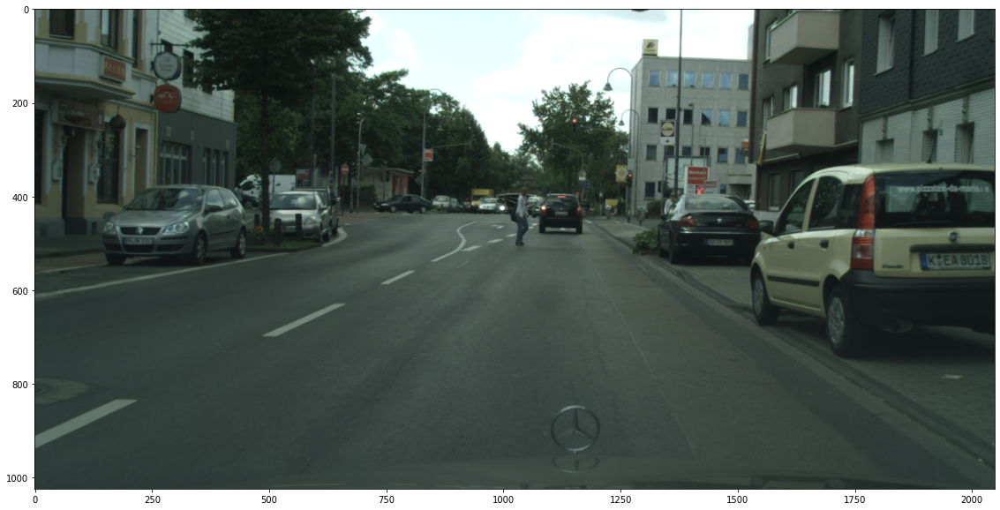

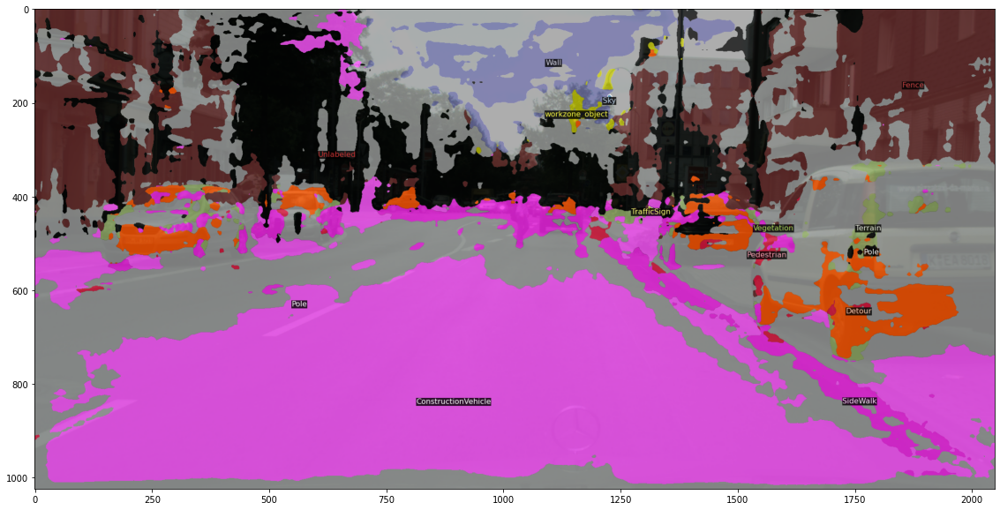

Time = 0.02928900718688965, freq = 34.142502462412594


In [11]:
# predictor = Detectron2Predictor(head='SemanticSegmentation', model_path='output_combined_all_40k/model_final.pth')
predictor = Detectron2Predictor(head='SemanticSegmentation', model_path='old_combined_all/model_final.pth')

for image_path in sample_cityscapes_file_path_list[:4]:
    output = predictor.test_image_file(image_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

Shape of sem_seg_head.predictor.bias in checkpoint is torch.Size([14]), while shape of sem_seg_head.predictor.bias in model is torch.Size([17]).
sem_seg_head.predictor.bias will not be loaded. Please double check and see if this is desired.
Shape of sem_seg_head.predictor.weight in checkpoint is torch.Size([14, 128, 1, 1]), while shape of sem_seg_head.predictor.weight in model is torch.Size([17, 128, 1, 1]).
sem_seg_head.predictor.weight will not be loaded. Please double check and see if this is desired.
Skip loading parameter 'sem_seg_head.predictor.bias' to the model due to incompatible shapes: (14,) in the checkpoint but (17,) in the model! You might want to double check if this is expected.
Skip loading parameter 'sem_seg_head.predictor.weight' to the model due to incompatible shapes: (14, 128, 1, 1) in the checkpoint but (17, 128, 1, 1) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
sem_seg_head.p

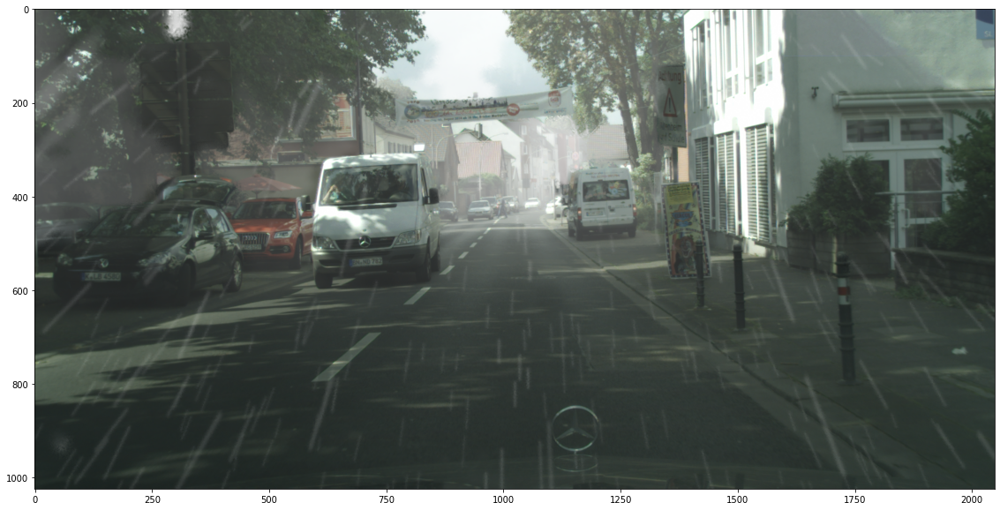

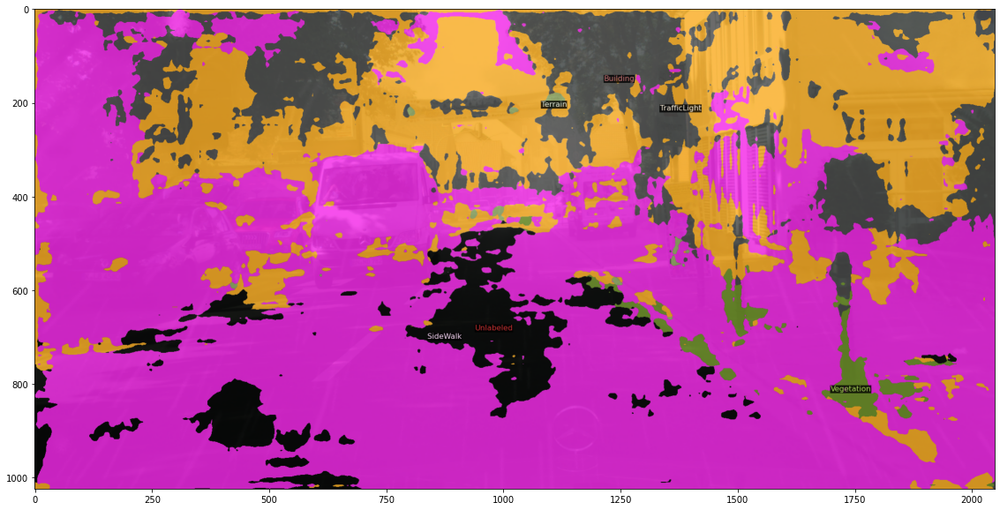

Time = 0.02982330322265625, freq = 33.53082629828601


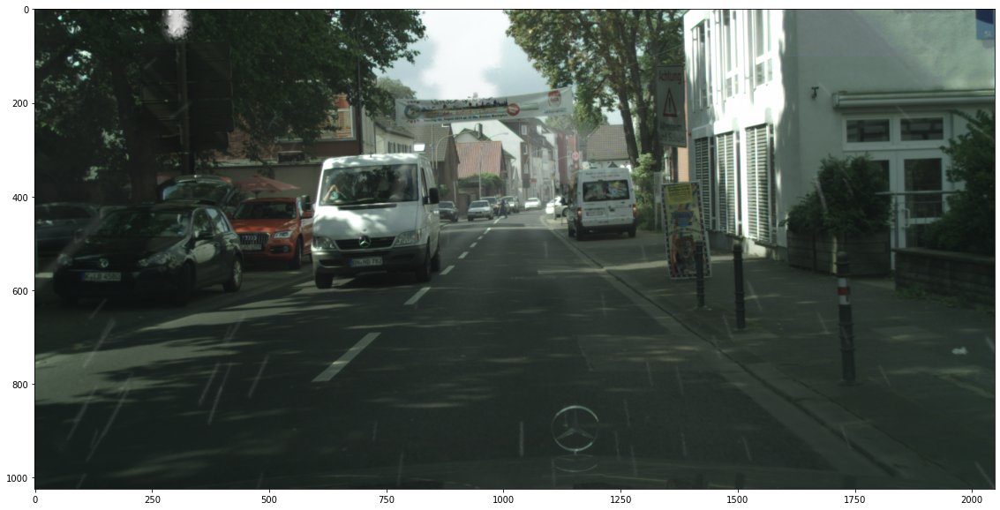

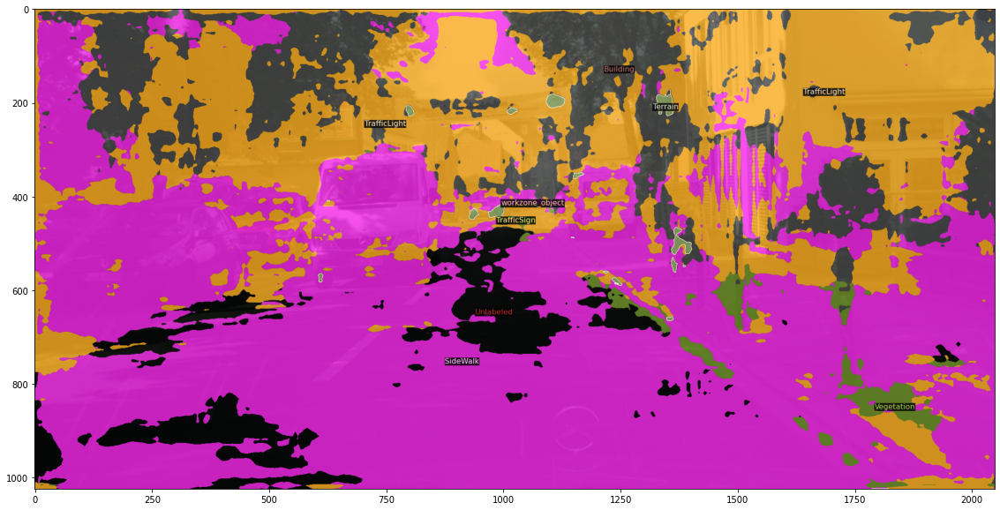

Time = 0.029029130935668945, freq = 34.448154931543975


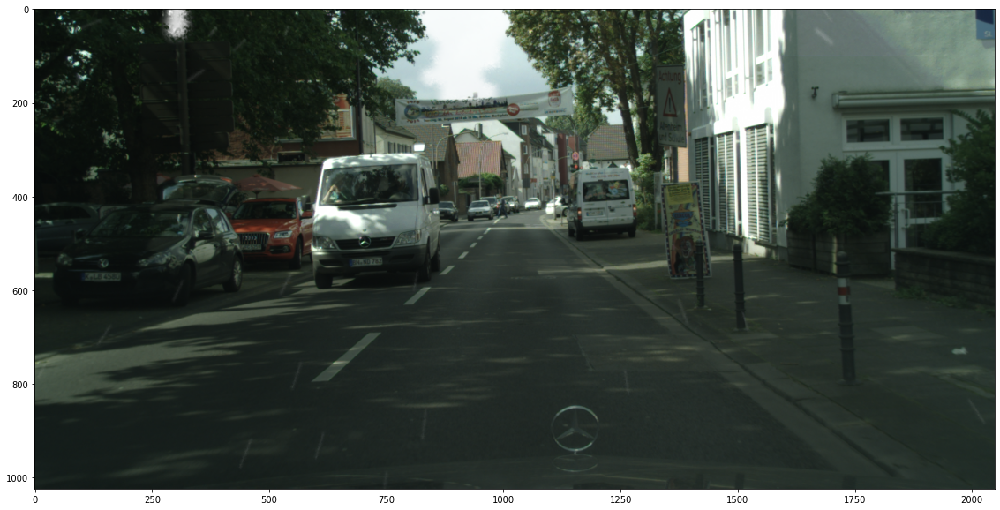

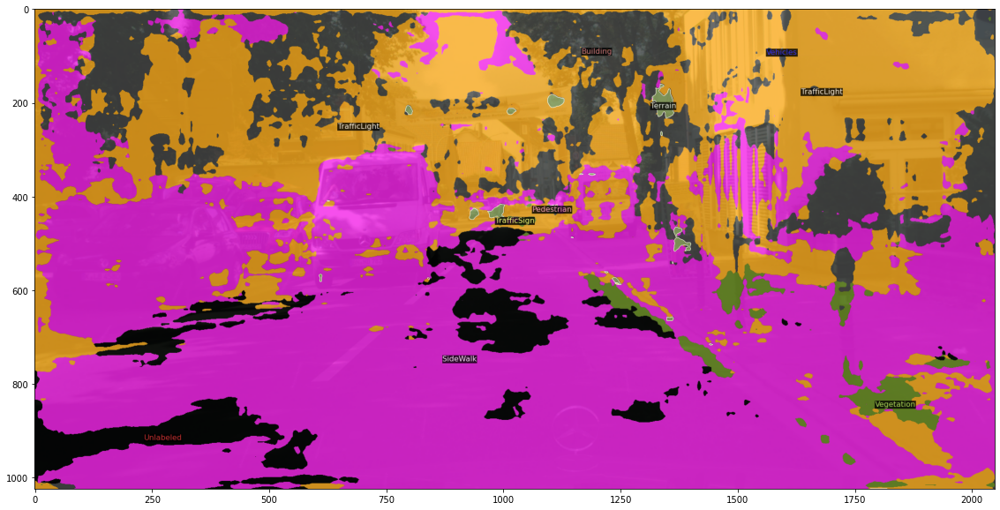

Time = 0.030005216598510742, freq = 33.3275381204758


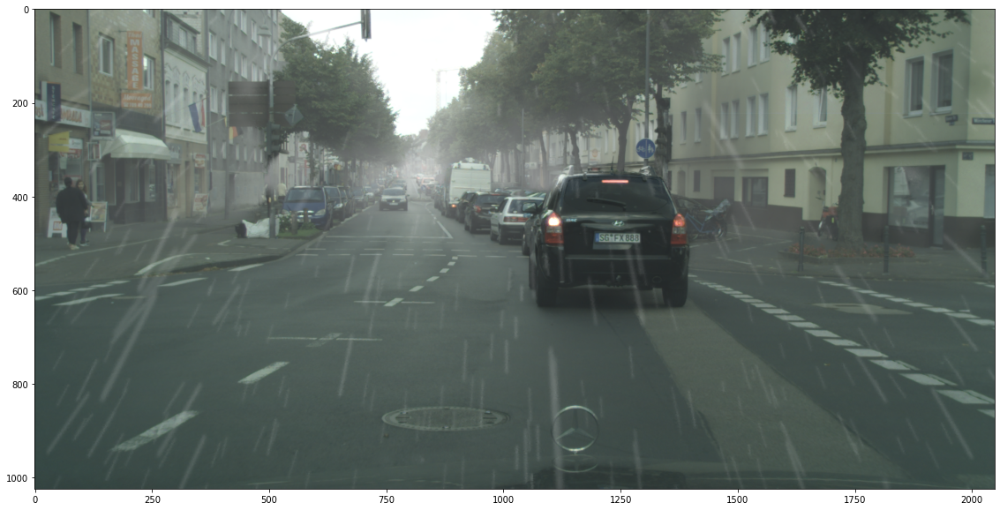

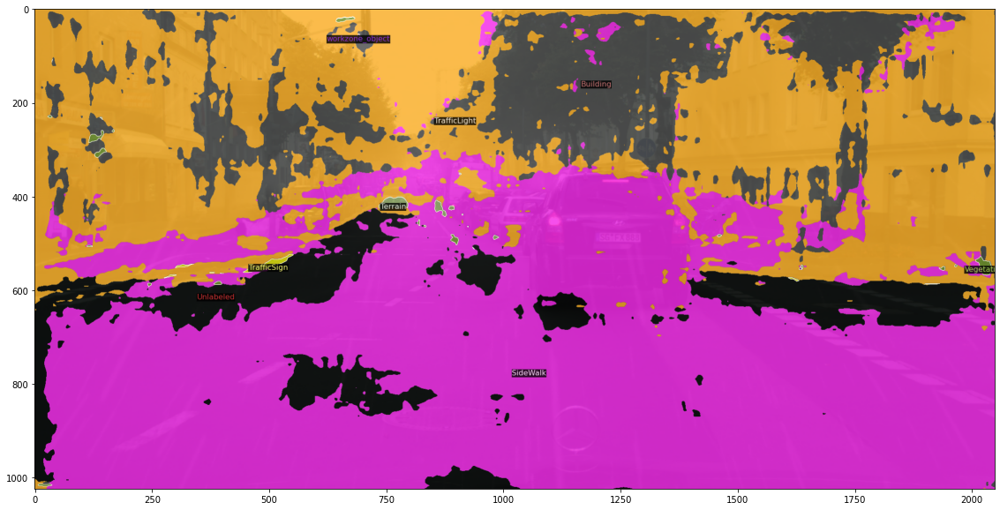

Time = 0.029223203659057617, freq = 34.21938305145589


In [12]:
data_dir_cityscapes = data_dir + 'RainRemoval/RainAddition/'
anno_dir_cityscapes = data_dir + 'Cityscapes/gtFine/'

_, sample_cityscapes_file_path_list = create_file_list(sub_dir=(data_dir_cityscapes + 'cologne'))

predictor = Detectron2Predictor(head='SemanticSegmentation', model_path='old_combined_all/model_final.pth')

for image_path in sample_cityscapes_file_path_list[:4]:
    output = predictor.test_image_file(image_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))

# Instance Segmentation

model_final_f10217.pkl: 178MB [00:04, 38.4MB/s]                                 
/home/gregory/.local/lib/python3.7/site-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


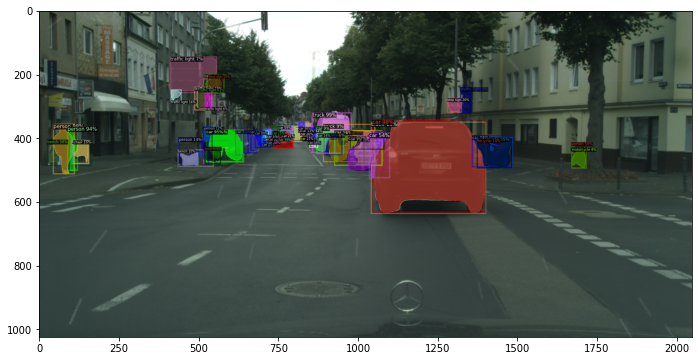

Time = 0.08870077133178711, freq = 11.273859121917653


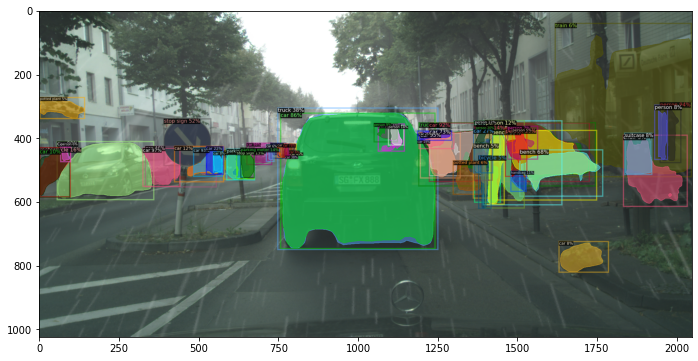

Time = 0.07891535758972168, freq = 12.671804710040938


In [13]:
predictor = Detectron2Predictor(head='InstanceSegmentation')

for image_path in sample_cityscapes_file_path_list[5:7]:
    output = predictor.test_image_file(image_path, show_prediction=True, measure_time=True)

# Panoptic Segmentation

model_final_c10459.pkl: 184MB [00:04, 38.4MB/s]                                 


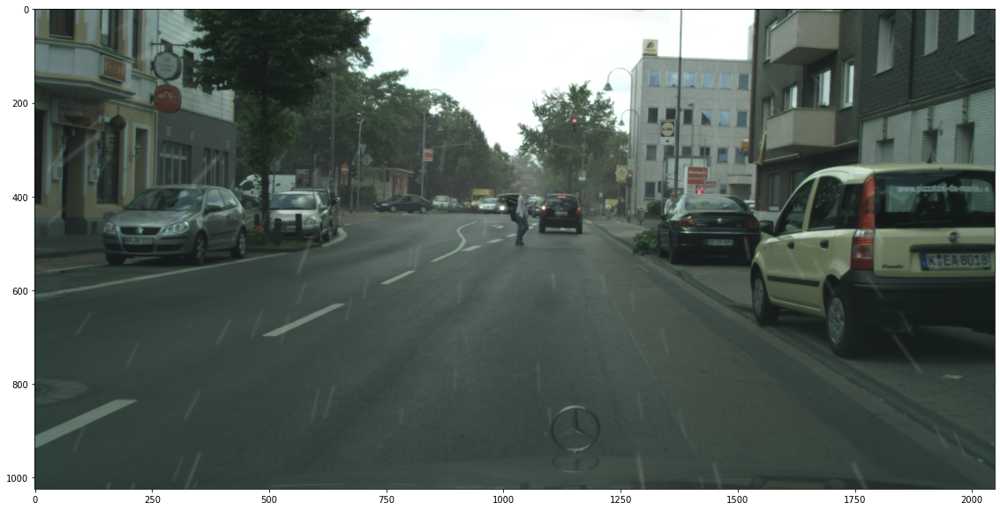

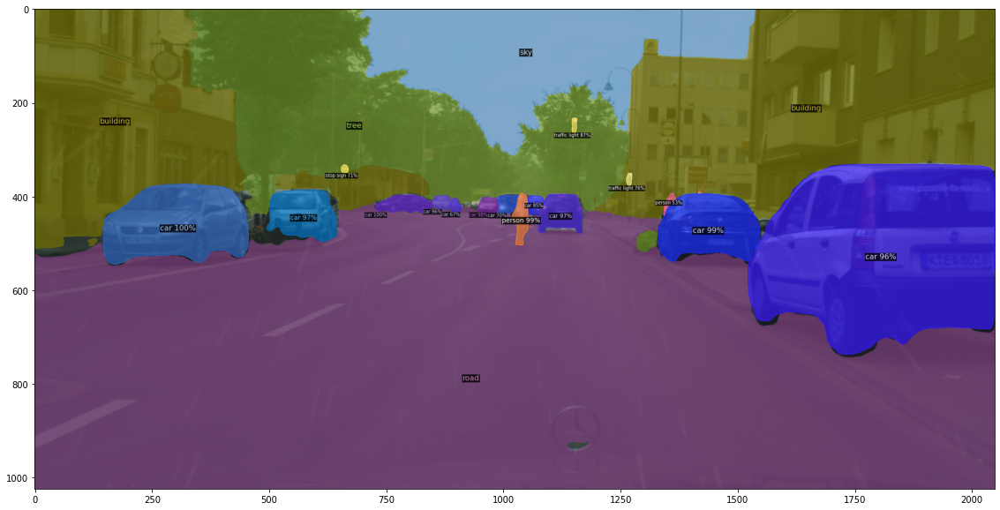

Time = 0.1252281665802002, freq = 7.9854239450161355


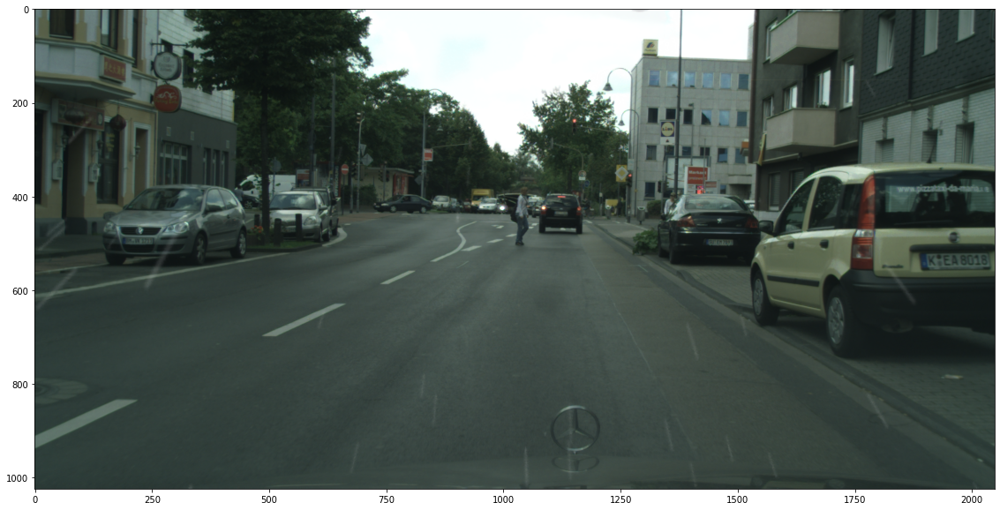

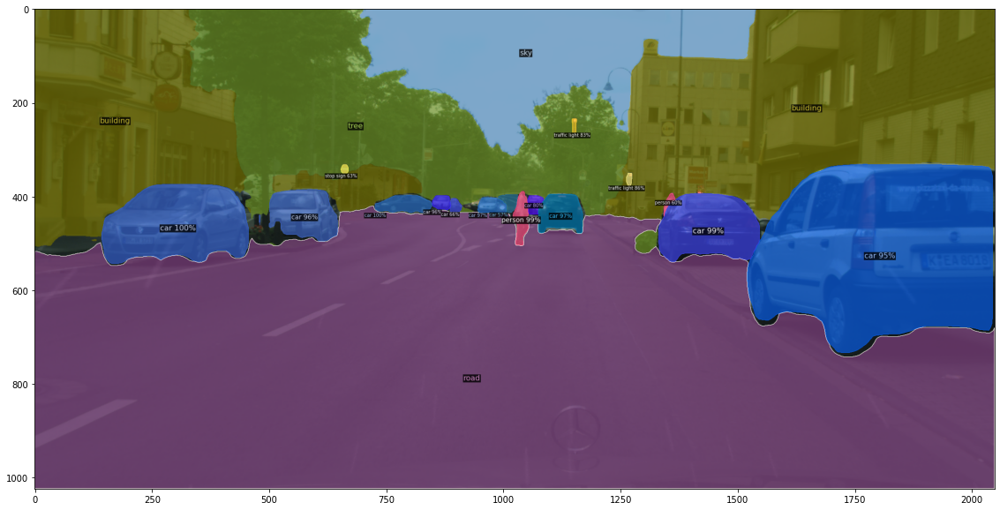

Time = 0.11245203018188477, freq = 8.892680713567882


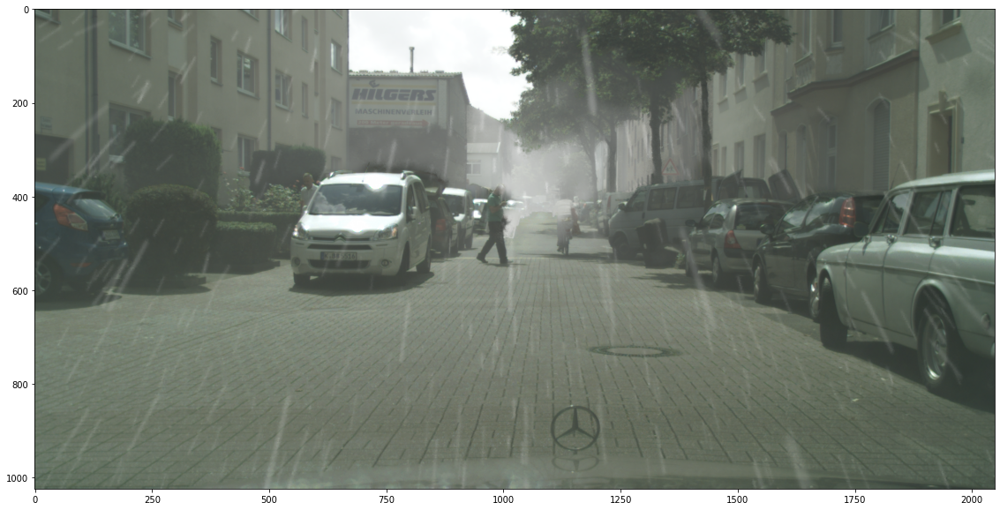

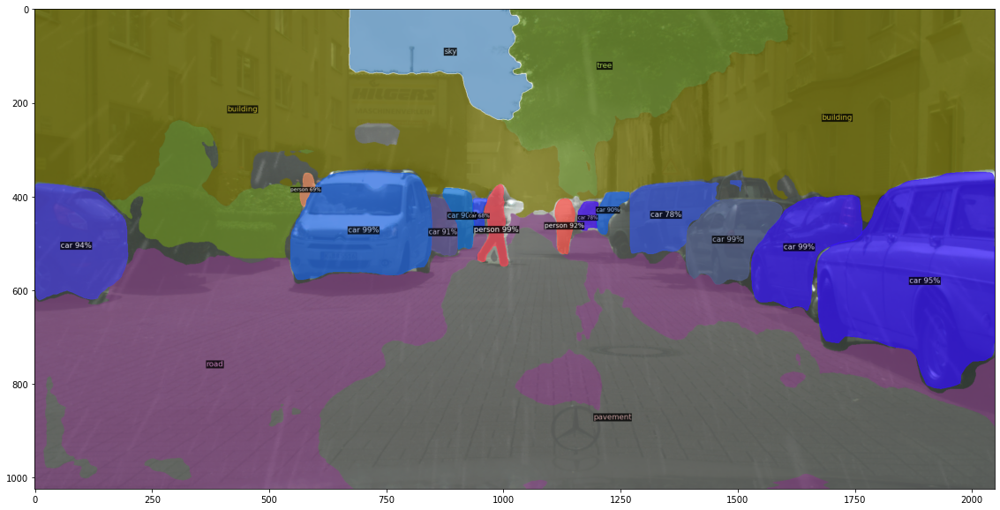

Time = 0.11612844467163086, freq = 8.611154681591039


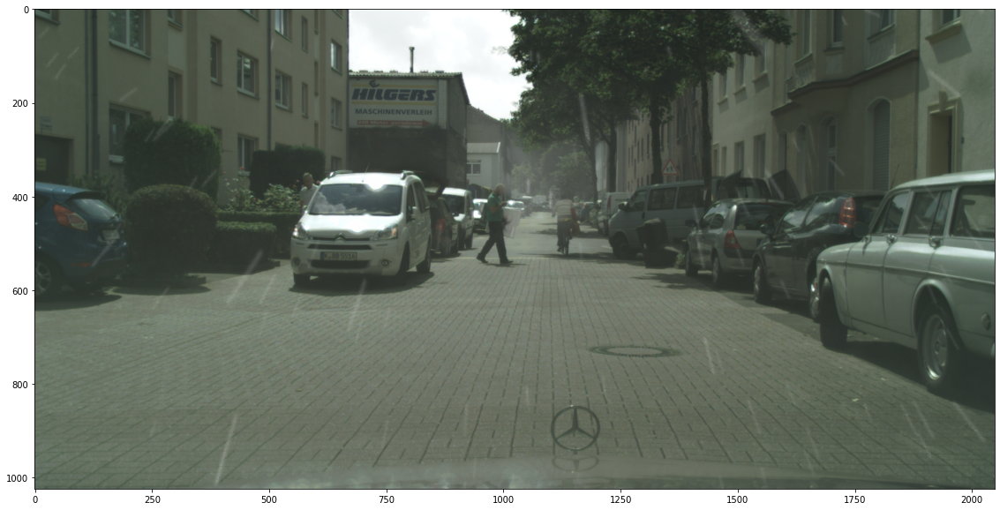

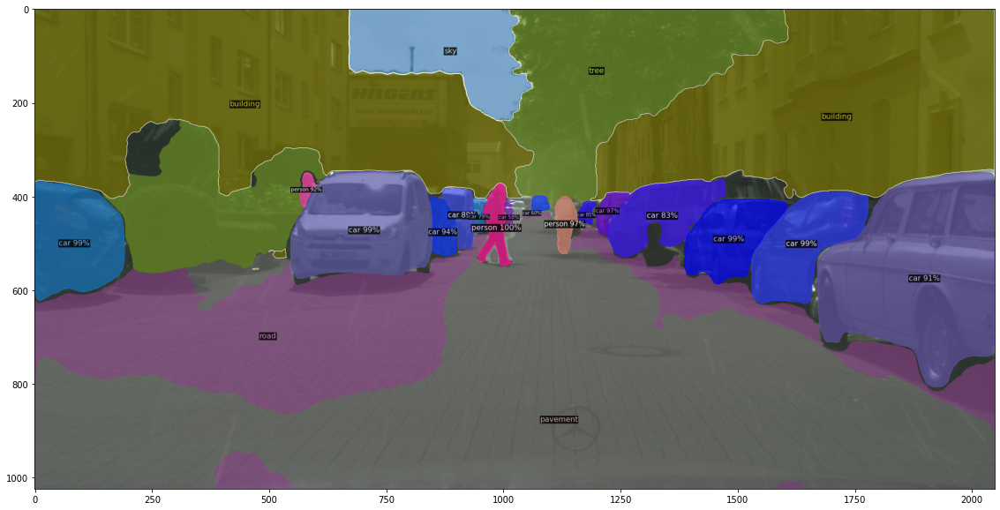

Time = 0.11206674575805664, freq = 8.923253666693615


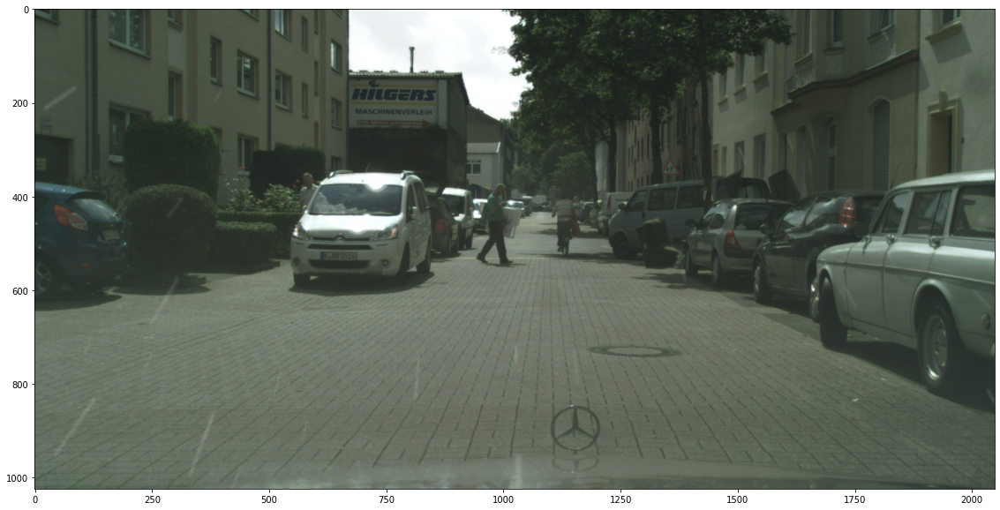

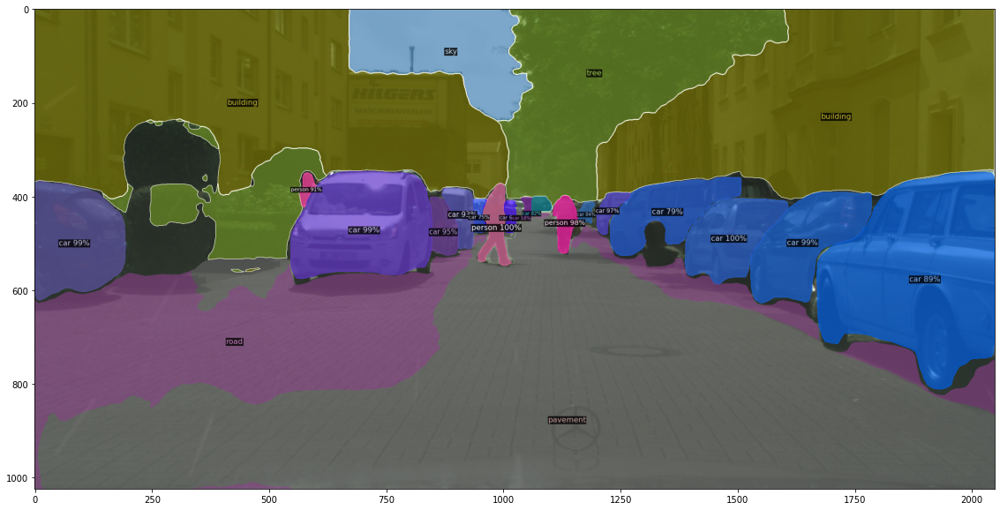

Time = 0.1124417781829834, freq = 8.893491513204626


In [14]:
predictor = Detectron2Predictor(head='PanopticSegmentation')

for image_path in sample_cityscapes_file_path_list[10:15]:
    output = predictor.test_image_file(image_path, show_prediction=True, show_original=True, measure_time=True, size=(20,10))